<a href="https://colab.research.google.com/github/nmoisseeva/lahaina/blob/main/radar_comparison.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install arm_pyart

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.3/14.3 MB 33.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.0/129.0 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 62.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 43.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 64.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.0/302.0 kB 13.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.5/184.5 kB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.7/77.7 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.3/47.3 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 61.2 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2024.10.0
    Uninstalling fsspec-2024.10.0:
      Successfully uninstalled fsspec-2024.10.0
ERROR: pip's dependency resolver does not curre

In [2]:
import pandas as pd
import os
import numpy as np
import pyart


## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



In [ ]:
#This code compares cross-wind and column-integrated modelled smoke with radar reflectivity

In [3]:
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 150


In [4]:
### INPUTS ###
radar_data_dir = '/content/drive/MyDrive/data/lahaina/radar'
fig_path = '/content/drive/MyDrive/colab/lahaina/figs/'


#gridding two radars
# https://arm-doe.github.io/pyart/examples/mapping/plot_map_two_radars_to_grid.html#sphx-glr-examples-mapping-plot-map-two-radars-to-grid-py

In [64]:
#create custom transparency cmap
from matplotlib.colors import ListedColormap

# Choose colormap
# cmap = plt.cm.inferno_r
cmap = plt.cm.cubehelix_r

# Get the colormap colors
alpha_cmap = cmap(np.arange(cmap.N))
# Set alpha
alpha_cmap[:,-1] = np.linspace(0, 0.8, 56).tolist() + (np.ones(200)*0.8).tolist()
# Create new colormap
alpha_cmap = ListedColormap(alpha_cmap)

In [6]:
#set up google tiles - CHECK THIS IS OK TO USE!
from cartopy.io.img_tiles import GoogleTiles
import cartopy.crs as ccrs

class ShadedReliefESRI(GoogleTiles):
    # shaded relief
    def _image_url(self, tile):
        x, y, z = tile
        # url = ('https://server.arcgisonline.com/ArcGIS/rest/services/' \
        #        'World_Shaded_Relief/MapServer/tile/{z}/{y}/{x}.jpg').format(
        #        z=z, y=y, x=x)
        url = ('https://server.arcgisonline.com/ArcGIS/rest/services/' \
               'World_Imagery/MapServer/tile/{z}/{y}/{x}.jpg').format(
               z=z, y=y, x=x)
        return url

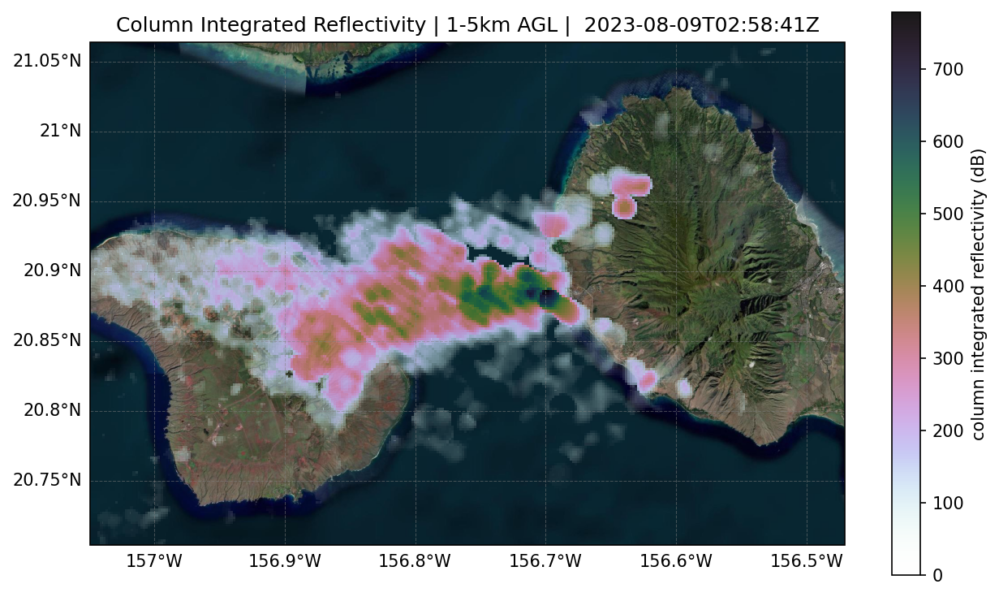

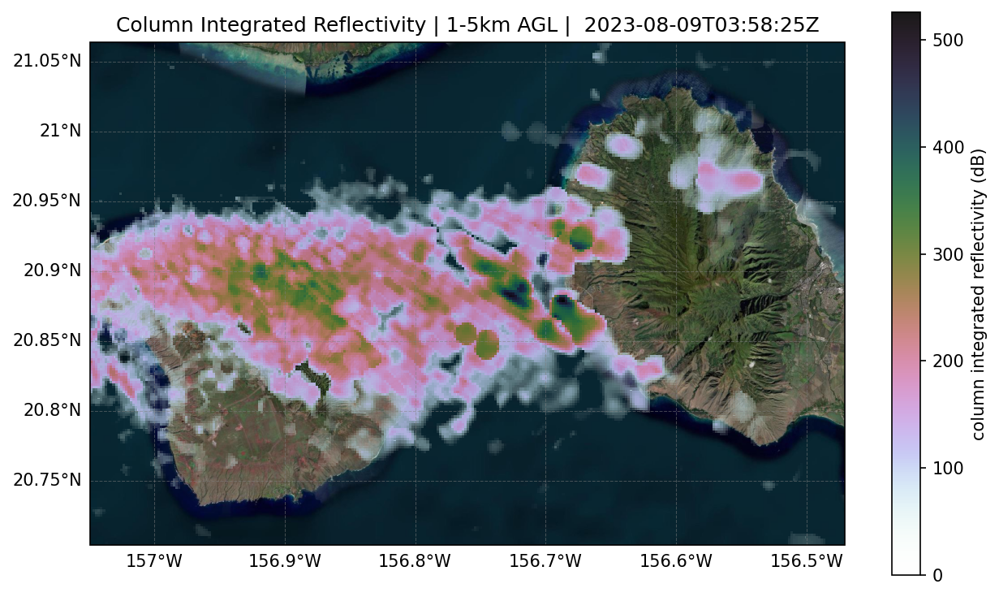

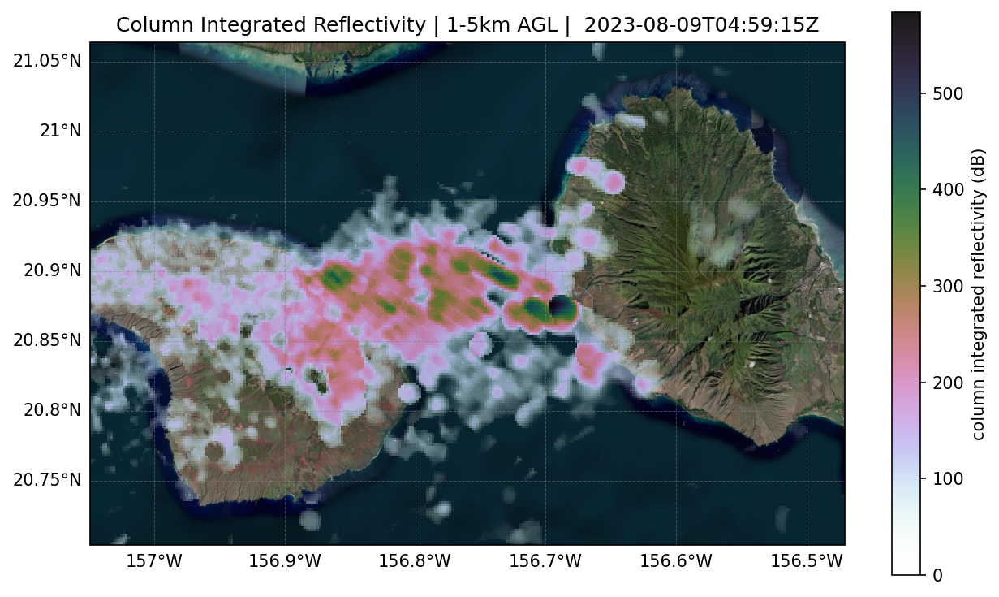

plot bounds: [-157.04893869461867, -156.47070987323278, 20.70377542388375, 21.063933405878963]


In [18]:
# for hr in ['00','01']:
for hr in ['03','04','05']:
  phkm_file = os.path.join(radar_data_dir, 'PHMO', f'PHMO20230809_{hr}')
  # phkm_file = os.path.join(radar_data_dir, 'PHKM', f'PHKM20230809_{hr}')

  radar_phkm = pyart.io.read(phkm_file)

  gatefilter_phkm = pyart.filters.GateFilter(radar_phkm)
  # gatefilter_phkm.exclude_transition()
  gatefilter_phkm.exclude_above('clutter_filter_power_removed', 5)
  gatefilter_phkm.include_below('clutter_filter_power_removed', 0.01)

  grid_phkm = pyart.map.grid_from_radars(
    (radar_phkm),
    gatefilters=(gatefilter_phkm),
    grid_shape=(40, 201, 301),
    grid_limits=((0, 5000), (-20000, 20000), (-40000, 20000)),
    grid_origin=(20.884069,-156.663453),
    grid_origin_alt=0,
    fields=['reflectivity','clutter_filter_power_removed'])


  ref_phkm = grid_phkm.fields['reflectivity']['data']
  clut_phkm = grid_phkm.fields['clutter_filter_power_removed']['data']

  # Plot column total
  lon, lat = grid_phkm.get_point_longitude_latitude(0)
  # Create a figure
  fig = plt.figure(figsize=(10,6))
  # Set the GeoAxes to the projection used by WRF
  ax = plt.axes(projection=ShadedReliefESRI().crs)

  #larger coverage
  ax.set_extent([lon.min(),lon.max(), lat.min(), lat.max()])


  ax.add_image(ShadedReliefESRI(), 9)

  column_total = np.nansum(ref_phkm[8:],0)

  #to match wrf d03
  ax.add_image(ShadedReliefESRI(), 12)
  plt.pcolormesh(lon, lat, column_total, vmin=0, transform=ccrs.PlateCarree(), cmap=alpha_cmap)
  plt.title(f'Column Integrated Reflectivity | 1-5km AGL |  {grid_phkm.radar_time["units"][-20:]}')
  gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True,linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
  gl.top_labels = False
  gl.right_labels = False
  plt.colorbar(label='column integrated reflectivity (dB)')

  plt.show()
print(f'plot bounds: {([lon.min(),lon.max(), lat.min(), lat.max()])}')

-16.5

In [ ]:
#consider deriving composite reflecgtivity and comparing directly to level 3 NEXRAD data

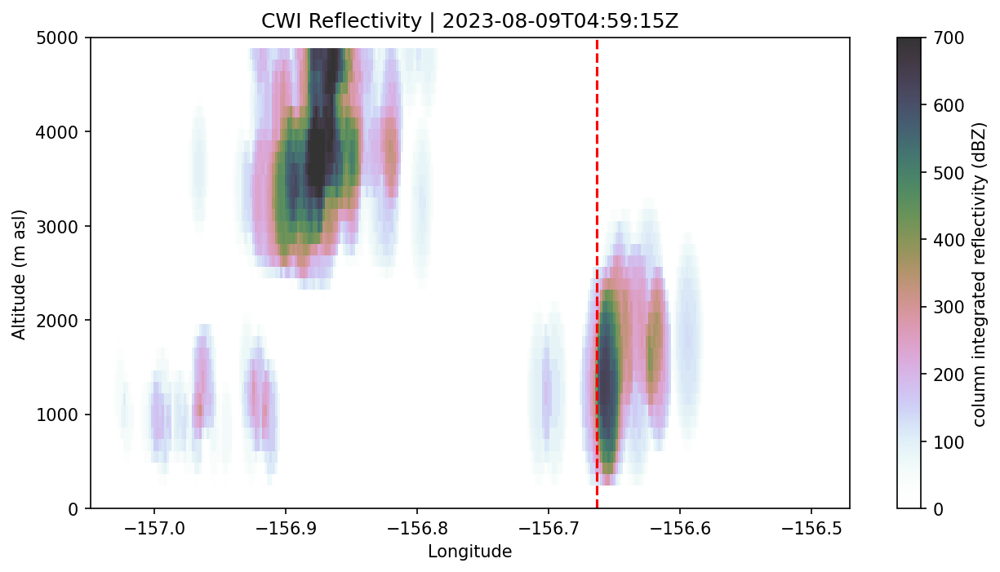

In [79]:
# prompt: use imshow to plot cwi total with  np.mean(lon, axis=0) horizontal axis and np.arange(0,5000,125)  for vertical  and  cmap=alpha_cmap,

# Plot column total with imshow
fig, ax = plt.subplots(figsize=(10, 5))
im = ax.imshow(cwi_total,
                 extent=[np.mean(lon, axis=0).min(), np.mean(lon, axis=0).max(), np.arange(0, 5000, 125).min(), np.arange(0, 5000, 125).max()],
                 cmap=alpha_cmap, vmin=0, vmax=700,
                 aspect='auto',
                 origin='lower')  # Use origin='lower' for correct vertical axis orientation
ax.vlines(x=-156.663453, ymin=0, ymax=5000, color='red', linestyles='--')
plt.title(f'CWI Reflectivity | {grid_phkm.radar_time["units"][-20:]}')
plt.xlabel('Longitude')
plt.ylabel('Altitude (m asl)')
ax.set(ylim=(0, 5000))
plt.colorbar(im, label='column integrated reflectivity (dBZ)')
plt.show()


In [47]:
plt.imshow(np.mean(lon, axis=0), np.arange(0,5000,125) ,cwi_total, cmap=alpha_cmap, vmin=0, vmax = 700, origin='lower')


TypeError: imshow() got multiple values for argument 'cmap'

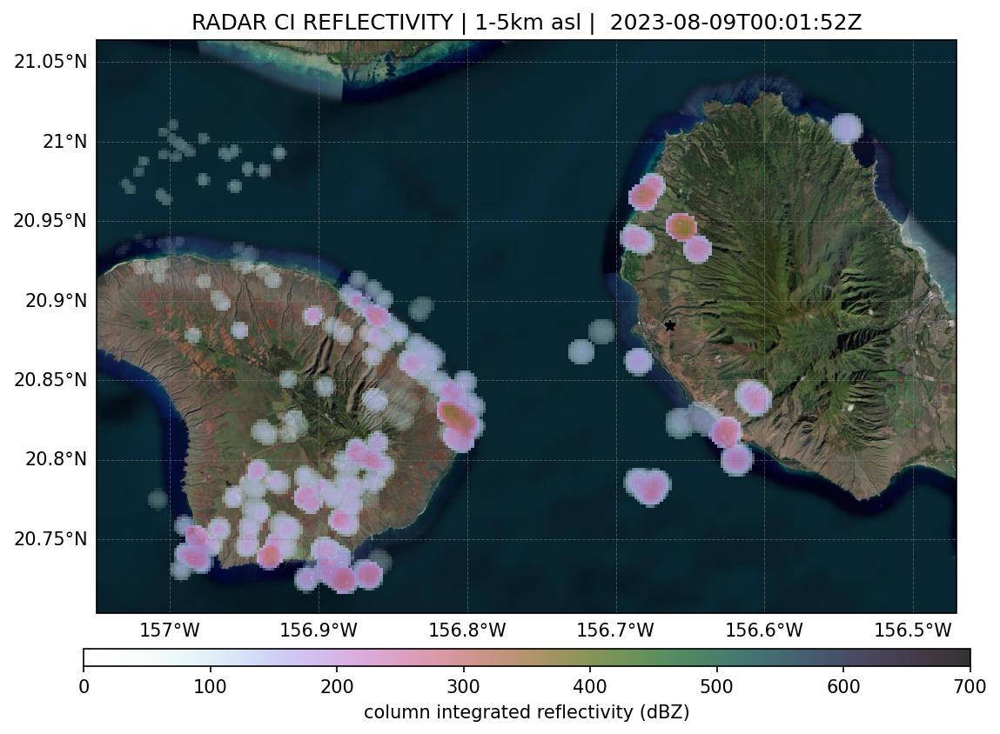

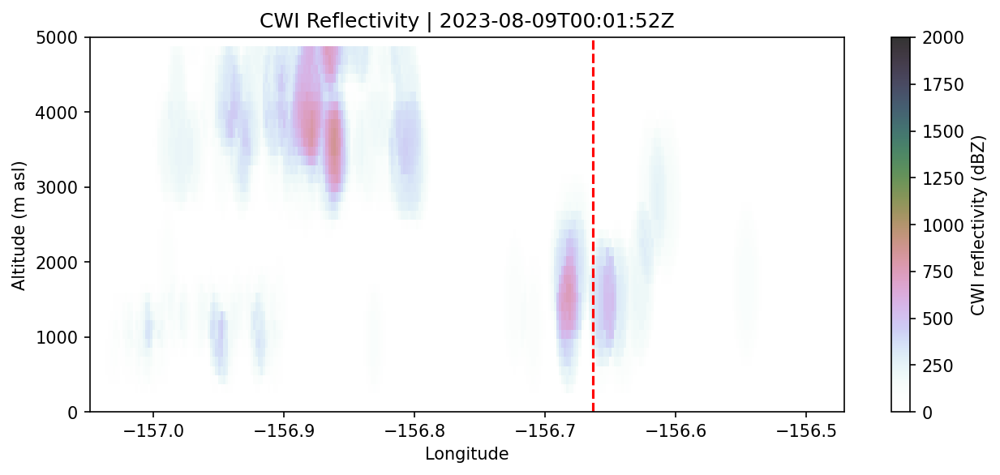

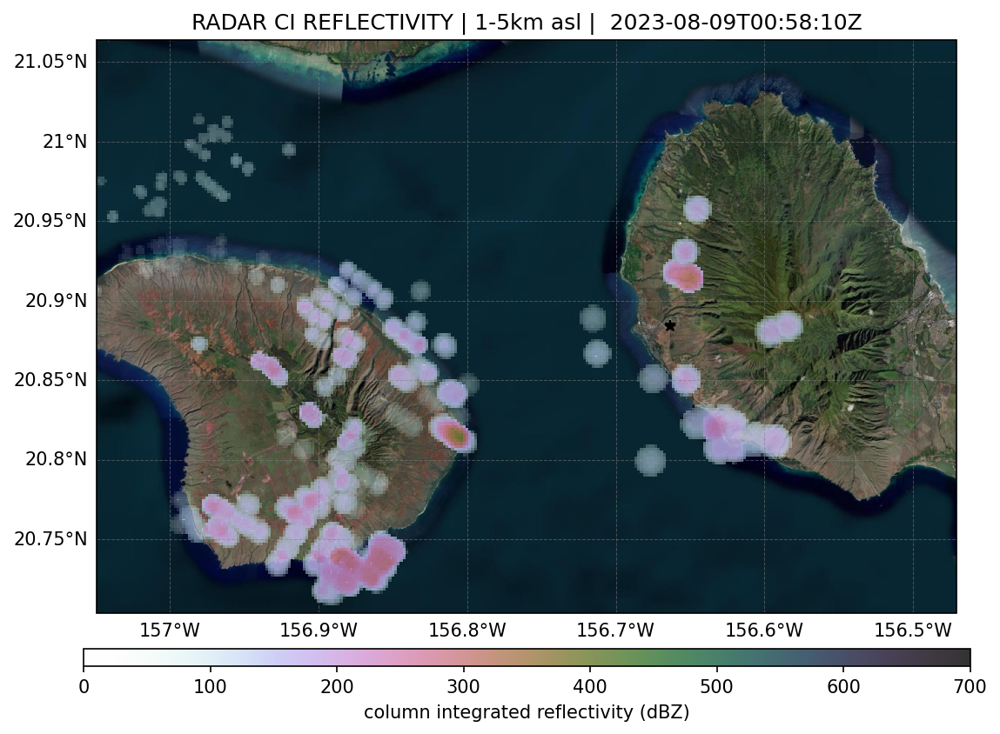

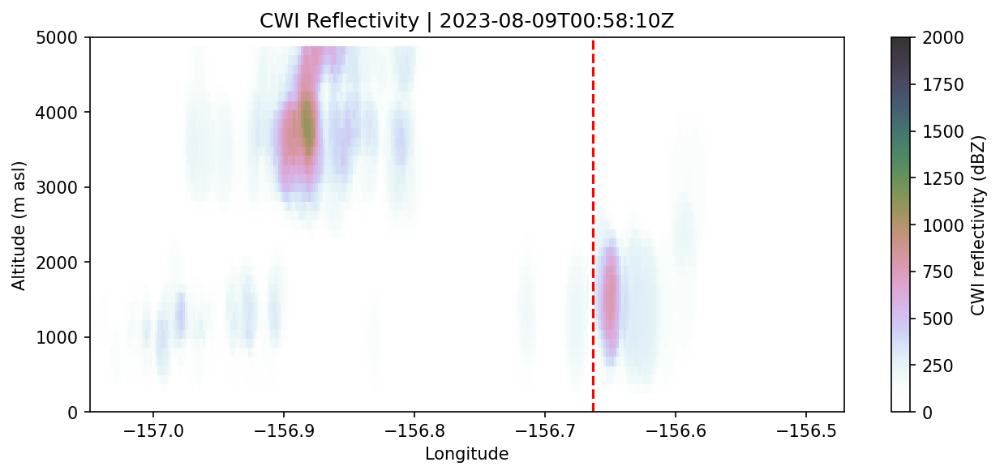

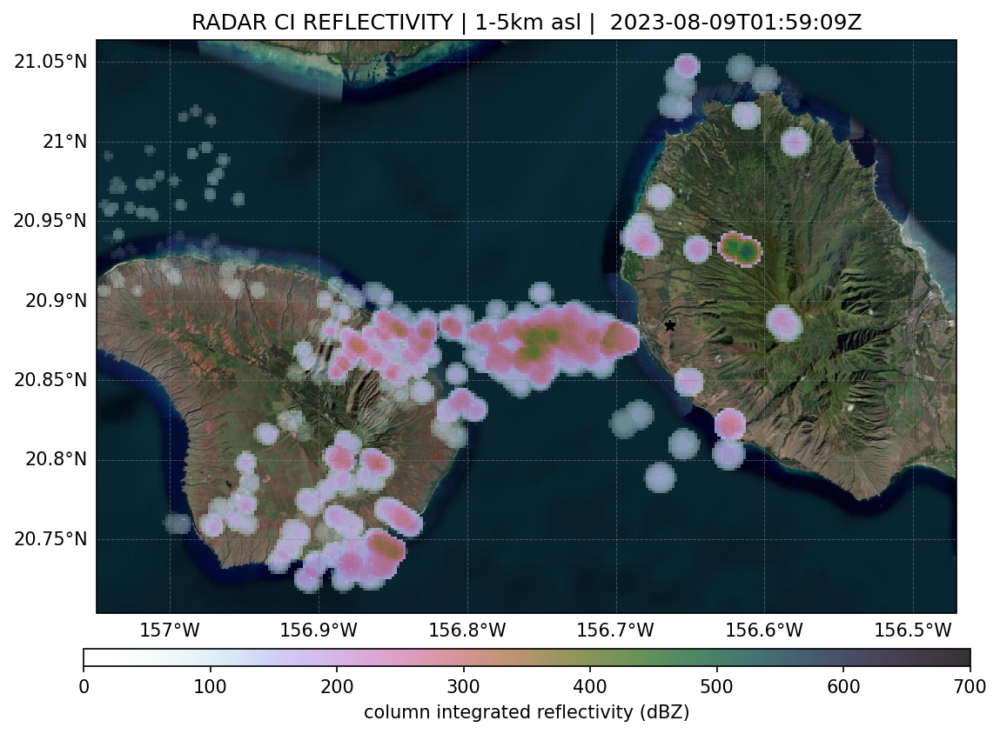

...

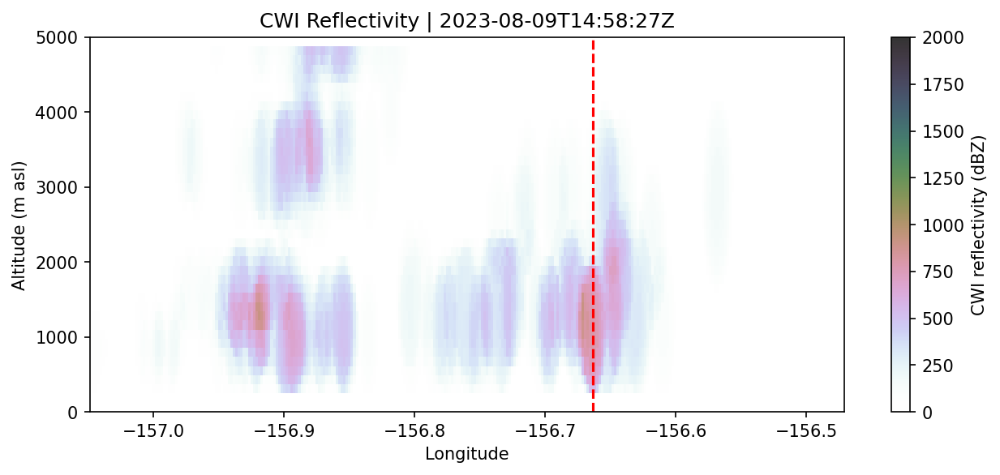

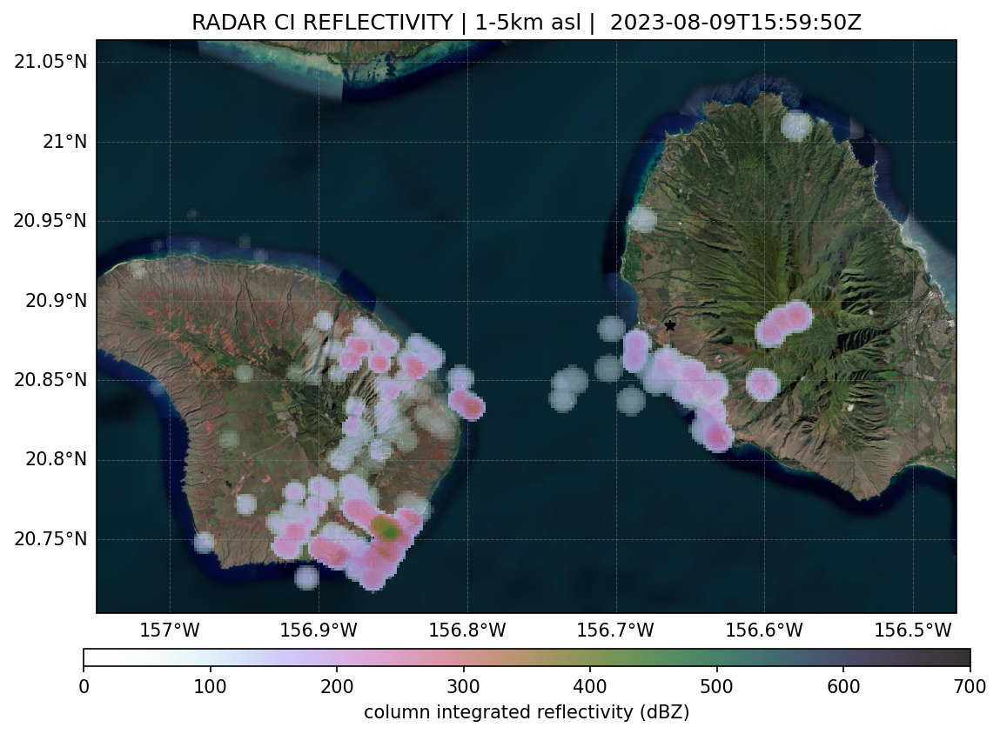

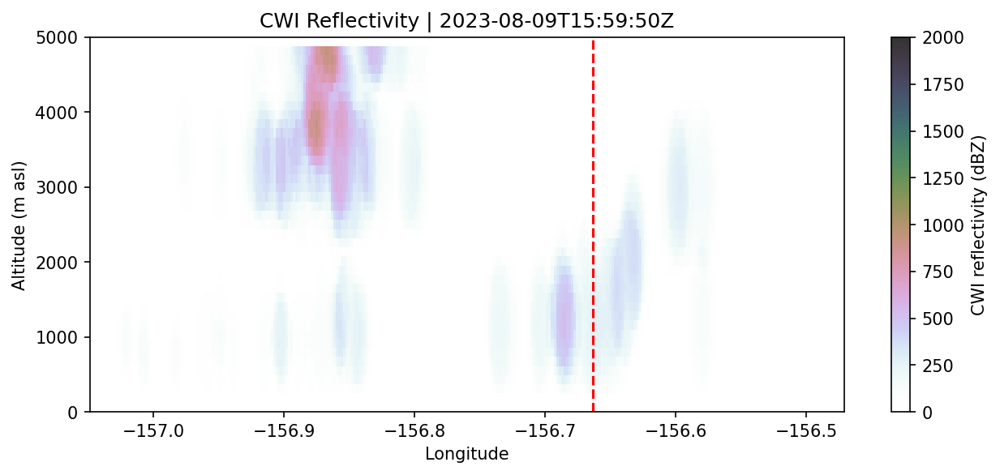

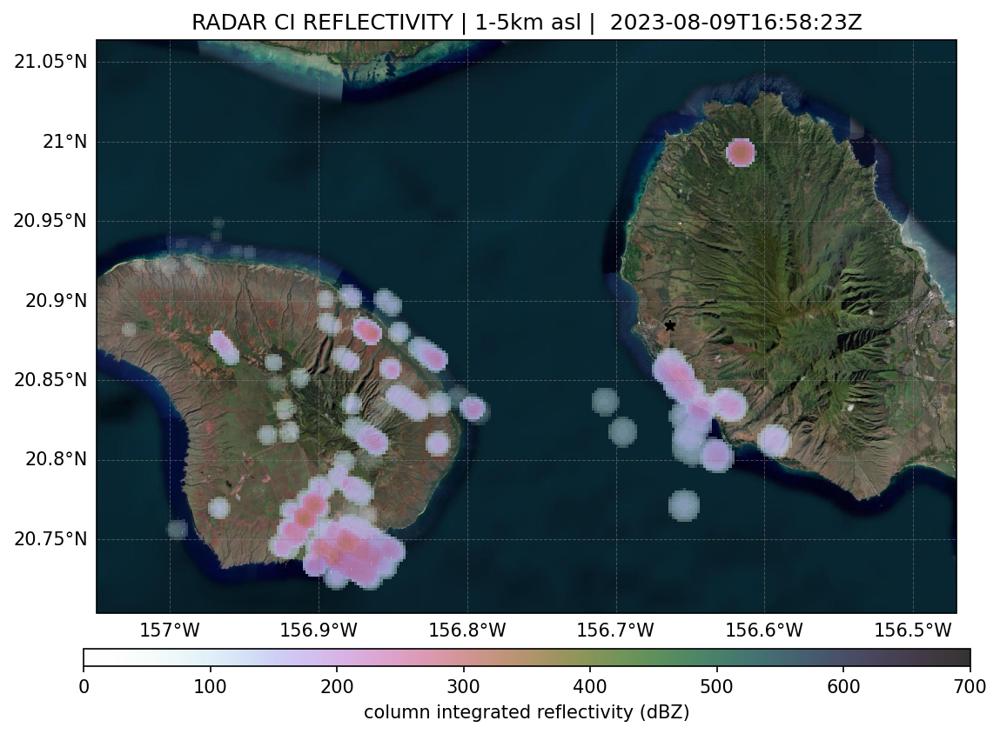

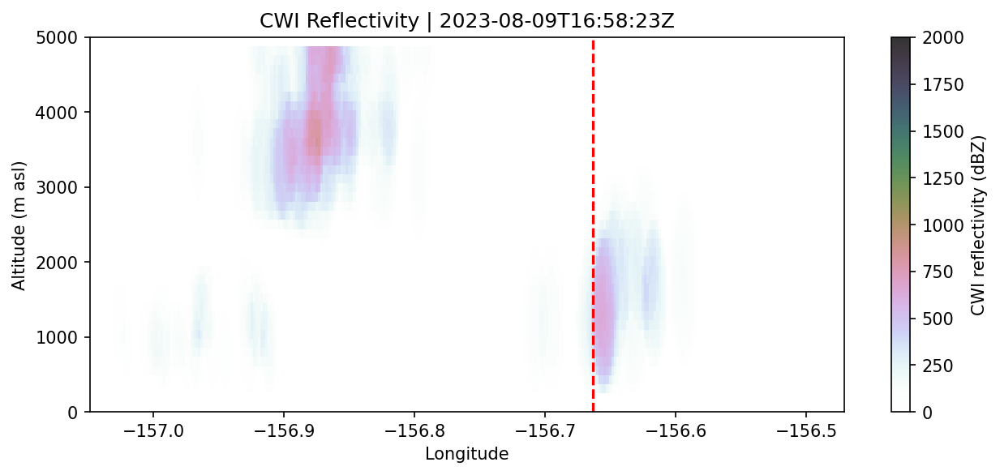

In [86]:
hours = [f"{hour:02d}" for hour in range(18)]

for hr in hours:
# for hr in ['02','03','04','05']:
  phmo_file = os.path.join(radar_data_dir, 'PHMO', f'PHMO20230809_{hr}')
  phkm_file = os.path.join(radar_data_dir, 'PHKM', f'PHKM20230809_{hr}')
  radar_phmo = pyart.io.read(phmo_file)
  radar_phkm = pyart.io.read(phkm_file)

  gatefilter_phmo = pyart.filters.GateFilter(radar_phmo)
  # gatefilter_phmo.exclude_transition()
  gatefilter_phmo.exclude_above('clutter_filter_power_removed', 5)
  gatefilter_phmo.include_below('clutter_filter_power_removed', 0.01)
  gatefilter_phmo.exclude_below('reflectivity', 10)

  gatefilter_phkm = pyart.filters.GateFilter(radar_phkm)
  # gatefilter_phkm.exclude_transition()
  gatefilter_phkm.include_below('clutter_filter_power_removed', 0.01)
  gatefilter_phkm.exclude_below('reflectivity', 10)

  # perform Cartesian mapping, limit to the reflectivity field.
  grid = pyart.map.grid_from_radars(
      (radar_phmo, radar_phkm),
      gatefilters=(gatefilter_phmo,gatefilter_phkm),
      grid_shape=(40, 201, 301),
      grid_limits=((0, 5000), (-20000, 20000), (-40000, 20000)),
      grid_origin=(20.884069,-156.663453),
      grid_origin_alt=0,
      fields=['reflectivity','clutter_filter_power_removed'])


  ref = grid.fields['reflectivity']['data']

  # Plot column total
  lon, lat = grid.get_point_longitude_latitude(0)
  column_total = np.nansum(ref[8:],0)


  cwi_total = np.nansum(ref,1)

  # --------COLUMN TOTAL--------
  fig = plt.figure(figsize=(10,6))
  # Set the GeoAxes to the projection used by WRF
  ax = plt.axes(projection=ShadedReliefESRI().crs)

  #larger coverage
  ax.set_extent([lon.min(),lon.max(), lat.min(), lat.max()])
  ax.add_image(ShadedReliefESRI(), 9)

  #to match wrf d03
  ax.add_image(ShadedReliefESRI(), 12)
  ax.plot(-156.663453,20.884069, marker="*", color="black", transform=ccrs.PlateCarree())

  plt.pcolormesh(lon, lat, column_total, cmap=alpha_cmap, vmin=0, vmax = 700, transform=ccrs.PlateCarree())
  plt.title(f'RADAR CI REFLECTIVITY | 1-5km asl |  {grid.radar_time["units"][-20:]}')
  gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True,linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
  gl.top_labels = False
  gl.right_labels = False
  plt.colorbar(label='column integrated reflectivity (dBZ)',shrink=0.7 ,orientation='horizontal', pad=0.05, aspect=50)

  plt.tight_layout()
  plt.savefig(fig_path + f'nexrad_ci_{grid.radar_time["units"][-9:-7:]}.png', dpi=300)
  plt.show()



  # # --------CWI TOTAL--------
  # Plot column total with imshow
  fig, ax = plt.subplots(figsize=(10, 4))
  im = ax.imshow(cwi_total,
                  extent=[np.mean(lon, axis=0).min(), np.mean(lon, axis=0).max(), np.arange(0, 5000, 125).min(), np.arange(0, 5000, 125).max()],
                  cmap=alpha_cmap, vmin=0, vmax=2000,
                  aspect='auto',
                  origin='lower')  # Use origin='lower' for correct vertical axis orientation
  ax.vlines(x=-156.663453, ymin=0, ymax=5000, color='red', linestyles='--')
  plt.title(f'CWI Reflectivity | {grid.radar_time["units"][-20:]}')
  plt.xlabel('Longitude')
  plt.ylabel('Altitude (m asl)')
  ax.set(ylim=(0, 5000))
  plt.colorbar(im, label='CWI reflectivity (dBZ)')
  plt.savefig(fig_path + f'nexrad_cw_{grid.radar_time["units"][-9:-7:]}.png', dpi=300)

  plt.show()

In [ ]:
###### OLDER PLOTTING CODE #####
# Plot hourly column total
lon, lat = grid.get_point_longitude_latitude(0)
# Create a figure
fig = plt.figure(figsize=(10,6))
# Set the GeoAxes to the projection used by WRF
ax = plt.axes(projection=ShadedReliefESRI().crs)

#larger coverage
ax.set_extent([lon.min(),lon.max(), lat.min(), lat.max()])
ax.add_image(ShadedReliefESRI(), 9)

column_total = np.nansum(ref[8:],0)

#to match wrf d03
ax.add_image(ShadedReliefESRI(), 12)
plt.pcolormesh(lon, lat, column_total, cmap=alpha_cmap, vmin=0,transform=ccrs.PlateCarree())
plt.title(f'Column Integrated Reflectivity | 1-5km AGL |  {grid.radar_time["units"][-20:]}')
gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True,linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False
plt.colorbar(label='column integrated reflectivity (dB)')

plt.show()

In [ ]:
### STUFF BELOW IS FOR HOURLY AVERAGES - FOR ARCHIVING PURPOSES ###

In [ ]:
# prompt: loop through files in /content/drive/MyDrive/data/lahaina/radar and store timestamps of each file as pandas array. Then group them for each hour


timestamps = []
filenames = []

# Loop through each file in the directory
for filename in os.listdir(radar_data_dir):
    if filename.endswith(('V06')):  # Adjust file extensions if necessary
        radar_filepath = os.path.join(radar_data_dir, filename)
        try:
            # Read radar data using pyart
            radar = pyart.io.read(radar_filepath)
            timestamps.append(radar.time['units'])
            filenames.append(filename)
            print(f"Processing file: {filename}")
            print(radar.time['units'])
        except Exception as e:
            print(f"Error processing file {filename}: {e}")


In [ ]:
#create a grouping dataframe
timestamps_series = pd.to_datetime(timestamps, format='seconds since %Y-%m-%dT%H:%M:%SZ')
df = pd.DataFrame({'timestamp': timestamps_series, 'filenames': filenames})
df.set_index('timestamp', inplace=True)

Processing file: PHMO20230809_000619_V06
Processing file: PHMO20230809_001255_V06
Processing file: PHMO20230809_001939_V06
Processing file: PHMO20230809_002615_V06
Processing file: PHMO20230809_003251_V06
Processing file: PHMO20230809_003929_V06
Processing file: PHMO20230809_004604_V06
Processing file: PHMO20230809_005244_V06
Processing file: PHMO20230809_005921_V06


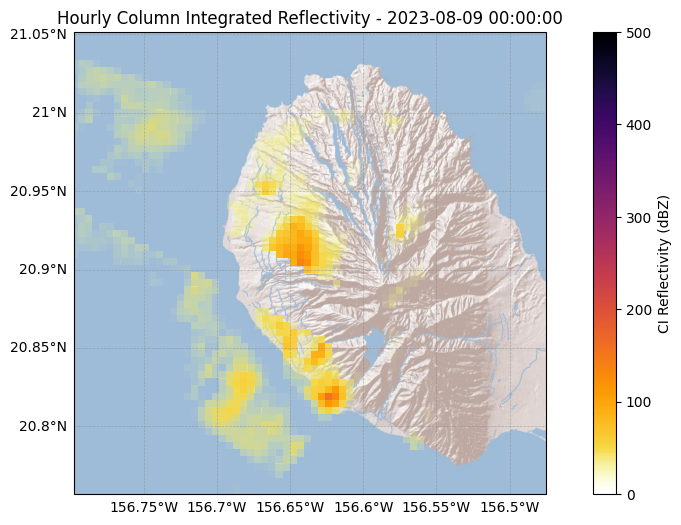

Processing file: PHMO20230809_010557_V06
Processing file: PHMO20230809_011233_V06
Processing file: PHMO20230809_011916_V06
Processing file: PHMO20230809_012600_V06
Processing file: PHMO20230809_013236_V06
Processing file: PHMO20230809_013913_V06
Processing file: PHMO20230809_014549_V06
Processing file: PHMO20230809_015232_V06
Processing file: PHMO20230809_015909_V06


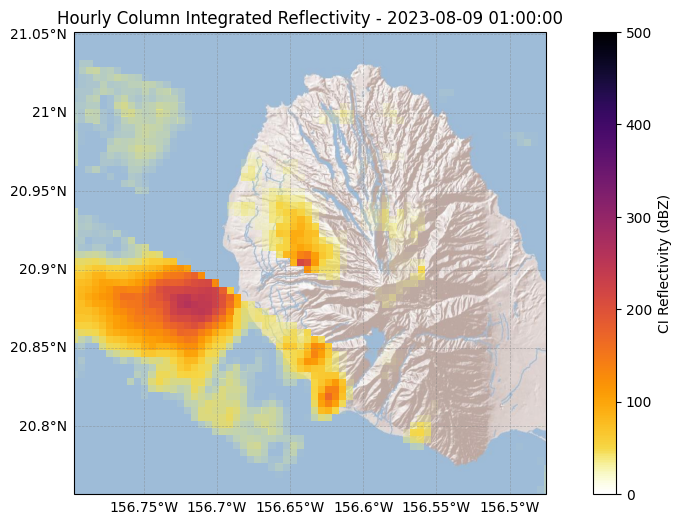

Processing file: PHMO20230809_020545_V06
Processing file: PHMO20230809_021221_V06
Processing file: PHMO20230809_021856_V06
Processing file: PHMO20230809_022533_V06
Processing file: PHMO20230809_023209_V06
Processing file: PHMO20230809_023853_V06
Processing file: PHMO20230809_024529_V06
Processing file: PHMO20230809_025205_V06
Processing file: PHMO20230809_025841_V06


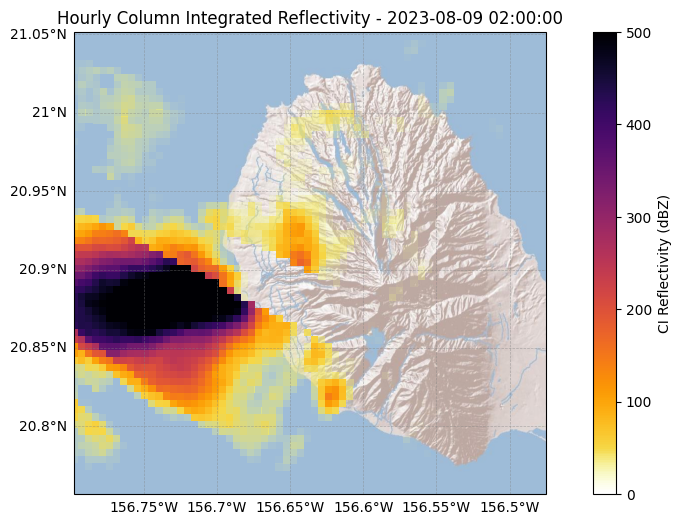

Processing file: PHMO20230809_030529_V06
Processing file: PHMO20230809_031204_V06
Processing file: PHMO20230809_031839_V06
Processing file: PHMO20230809_032515_V06
Processing file: PHMO20230809_033155_V06
Processing file: PHMO20230809_033832_V06
Processing file: PHMO20230809_034513_V06
Processing file: PHMO20230809_035149_V06
Processing file: PHMO20230809_035825_V06


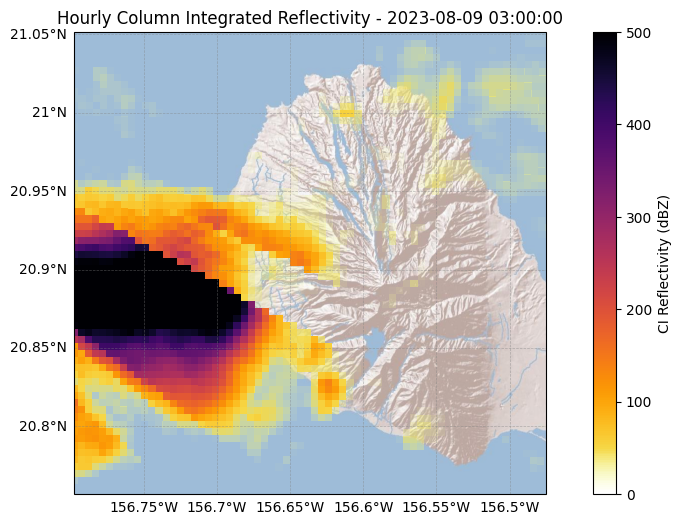

Processing file: PHMO20230809_040501_V06
Processing file: PHMO20230809_041247_V06
Processing file: PHMO20230809_041927_V06
Processing file: PHMO20230809_042610_V06
Processing file: PHMO20230809_043246_V06
Processing file: PHMO20230809_043923_V06
Processing file: PHMO20230809_044600_V06
Processing file: PHMO20230809_045236_V06
Processing file: PHMO20230809_045915_V06


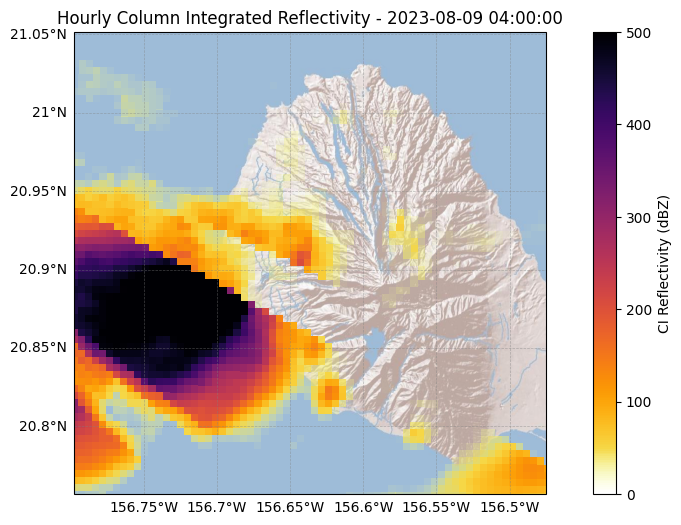

Processing file: PHMO20230809_050552_V06
Processing file: PHMO20230809_051233_V06
Processing file: PHMO20230809_051908_V06
Processing file: PHMO20230809_052547_V06
Processing file: PHMO20230809_053227_V06
Processing file: PHMO20230809_053911_V06
Processing file: PHMO20230809_054555_V06
Processing file: PHMO20230809_055238_V06
Processing file: PHMO20230809_055923_V06


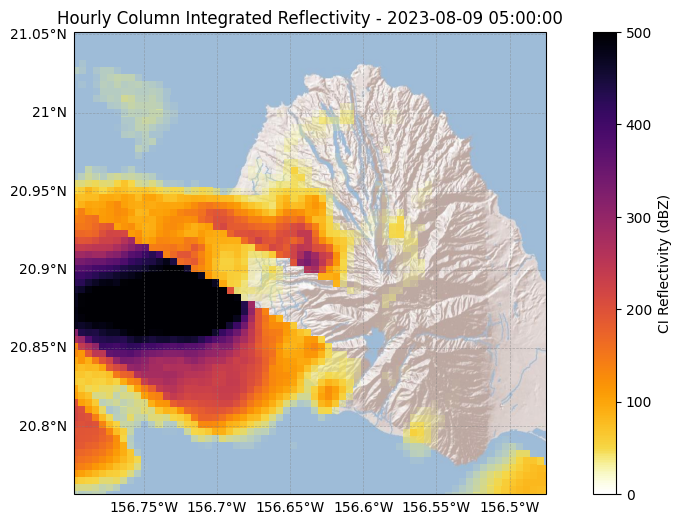

Processing file: PHMO20230809_060611_V06
Processing file: PHMO20230809_061255_V06
Processing file: PHMO20230809_061939_V06
Processing file: PHMO20230809_062628_V06
Processing file: PHMO20230809_063312_V06
Processing file: PHMO20230809_063957_V06
Processing file: PHMO20230809_064641_V06
Processing file: PHMO20230809_065325_V06


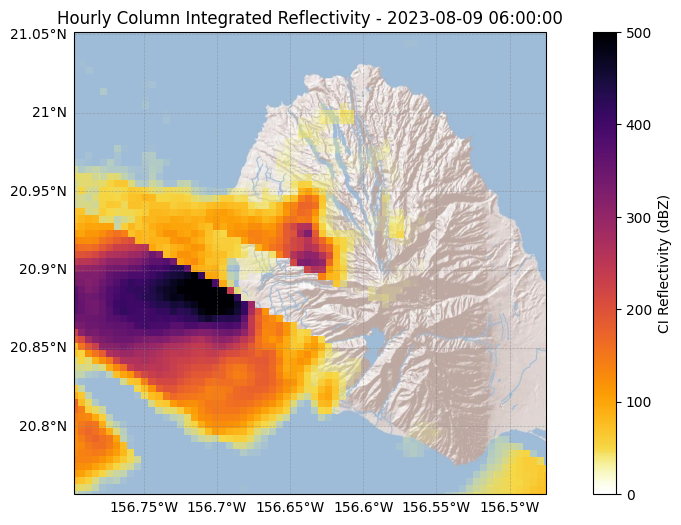

Processing file: PHMO20230809_070008_V06
Processing file: PHMO20230809_070656_V06
Processing file: PHMO20230809_071336_V06
Processing file: PHMO20230809_072016_V06
Processing file: PHMO20230809_072653_V06
Processing file: PHMO20230809_073336_V06
Processing file: PHMO20230809_074016_V06
Processing file: PHMO20230809_074656_V06
Processing file: PHMO20230809_075350_V06


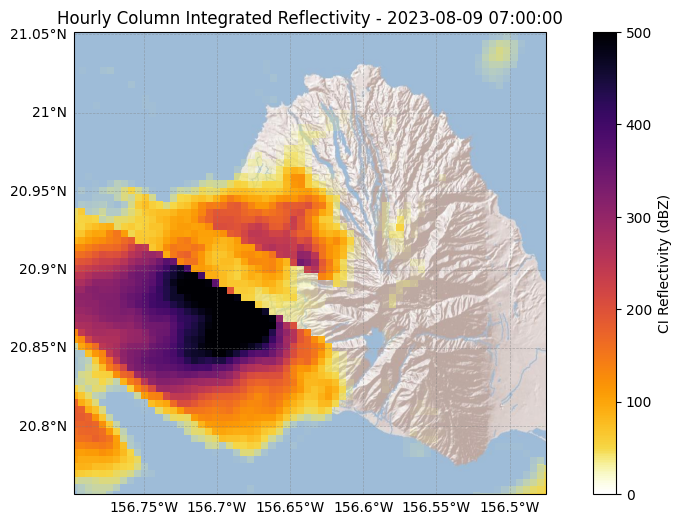

Processing file: PHMO20230809_080034_V06
Processing file: PHMO20230809_080717_V06
Processing file: PHMO20230809_081357_V06
Processing file: PHMO20230809_082037_V06
Processing file: PHMO20230809_082713_V06
Processing file: PHMO20230809_083349_V06
Processing file: PHMO20230809_084024_V06
Processing file: PHMO20230809_084701_V06
Processing file: PHMO20230809_085338_V06


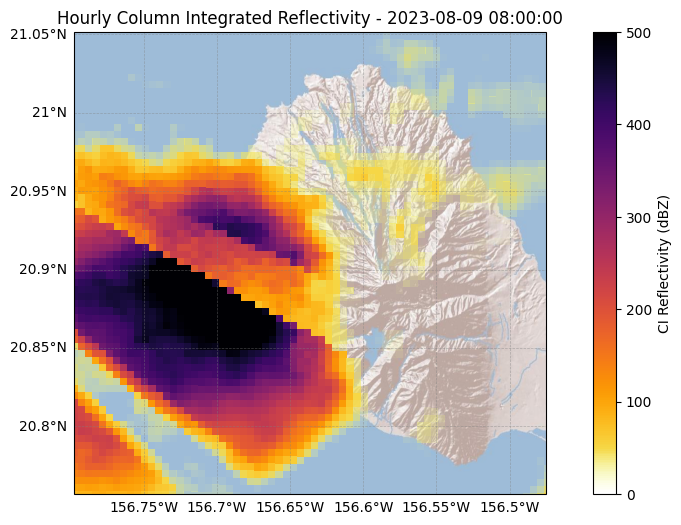

Processing file: PHMO20230809_090015_V06
Processing file: PHMO20230809_090652_V06
Processing file: PHMO20230809_091329_V06
Processing file: PHMO20230809_092006_V06
Processing file: PHMO20230809_092642_V06
Processing file: PHMO20230809_093319_V06
Processing file: PHMO20230809_093954_V06
Processing file: PHMO20230809_094630_V06
Processing file: PHMO20230809_095319_V06
Processing file: PHMO20230809_095956_V06


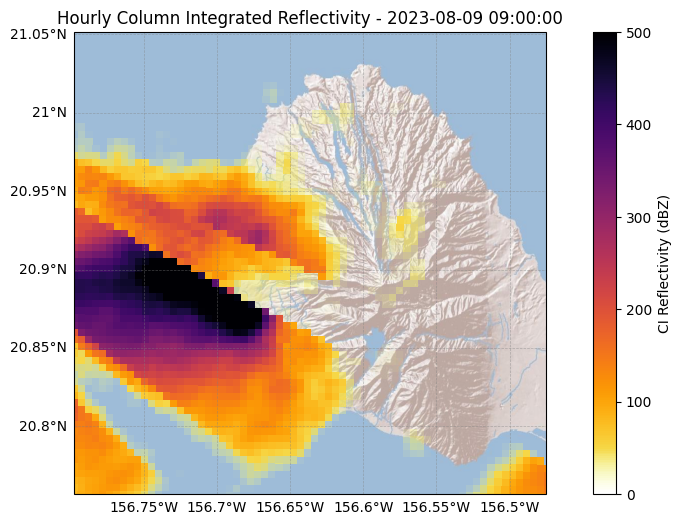

Processing file: PHMO20230809_100635_V06
Processing file: PHMO20230809_101311_V06
Processing file: PHMO20230809_101947_V06
Processing file: PHMO20230809_102623_V06
Processing file: PHMO20230809_103259_V06
Processing file: PHMO20230809_103935_V06
Processing file: PHMO20230809_104611_V06
Processing file: PHMO20230809_105248_V06
Processing file: PHMO20230809_105925_V06


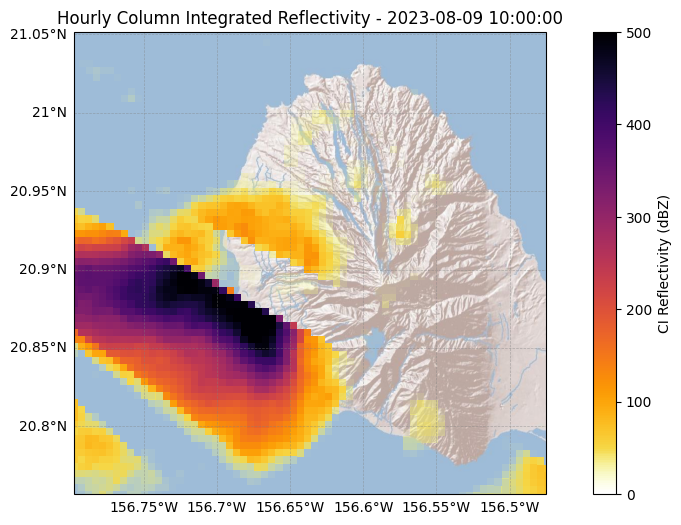

Processing file: PHMO20230809_110608_V06
Processing file: PHMO20230809_111249_V06
Processing file: PHMO20230809_111929_V06
Processing file: PHMO20230809_112617_V06
Processing file: PHMO20230809_113307_V06
Processing file: PHMO20230809_113955_V06
Processing file: PHMO20230809_114643_V06
Processing file: PHMO20230809_115338_V06


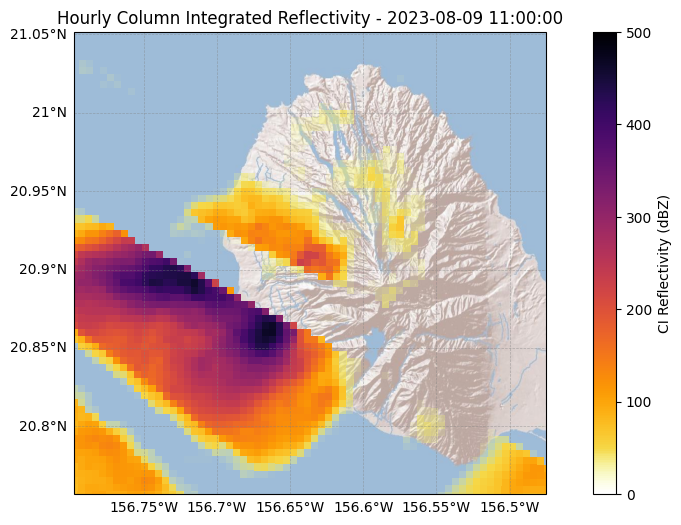

Processing file: PHMO20230809_120027_V06
Processing file: PHMO20230809_120715_V06
Processing file: PHMO20230809_121517_V06
Processing file: PHMO20230809_122206_V06
Processing file: PHMO20230809_122901_V06
Processing file: PHMO20230809_123550_V06
Processing file: PHMO20230809_124239_V06
Processing file: PHMO20230809_124928_V06
Processing file: PHMO20230809_125617_V06


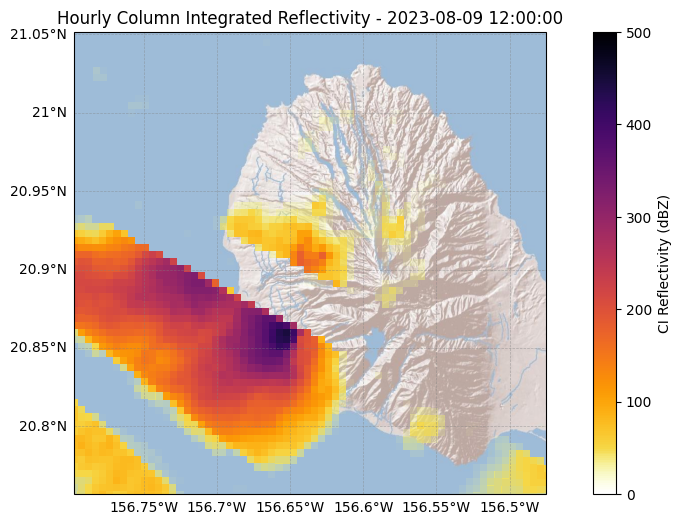

Processing file: PHMO20230809_130301_V06
Processing file: PHMO20230809_130945_V06
Processing file: PHMO20230809_131628_V06
Processing file: PHMO20230809_132323_V06
Processing file: PHMO20230809_133012_V06
Processing file: PHMO20230809_133701_V06
Processing file: PHMO20230809_134350_V06
Processing file: PHMO20230809_135038_V06
Processing file: PHMO20230809_135719_V06


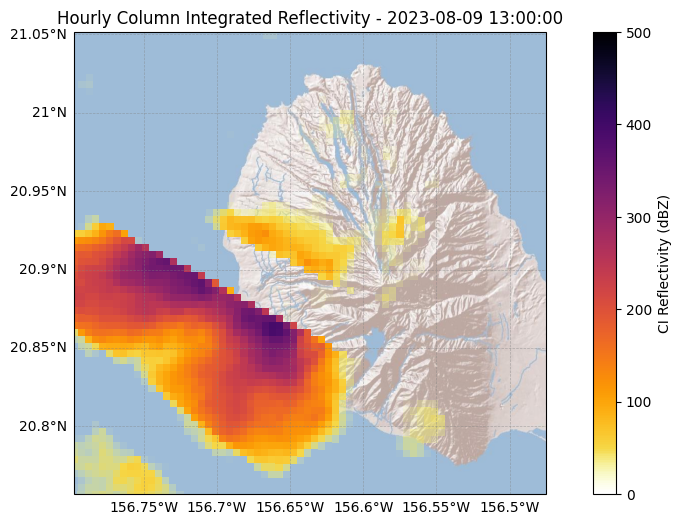

Processing file: PHMO20230809_140407_V06
Processing file: PHMO20230809_141051_V06
Processing file: PHMO20230809_141745_V06
Processing file: PHMO20230809_142428_V06
Processing file: PHMO20230809_143117_V06
Processing file: PHMO20230809_143805_V06
Processing file: PHMO20230809_144450_V06
Processing file: PHMO20230809_145138_V06
Processing file: PHMO20230809_145827_V06


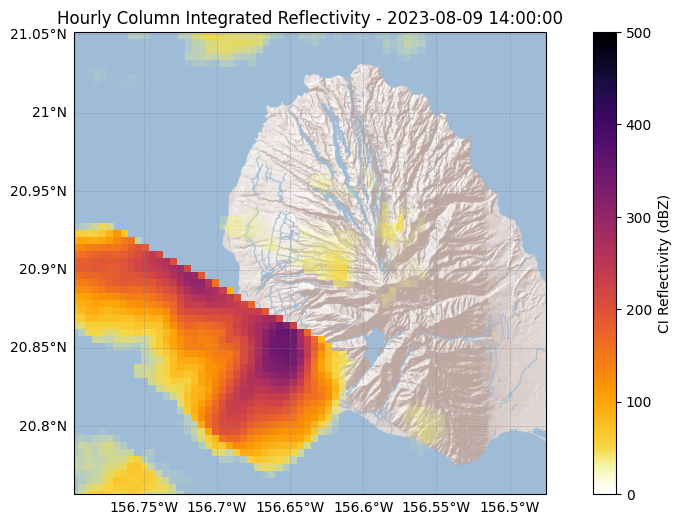

Processing file: PHMO20230809_150517_V06
Processing file: PHMO20230809_151206_V06
Processing file: PHMO20230809_151856_V06
Processing file: PHMO20230809_152545_V06
Processing file: PHMO20230809_153224_V06
Processing file: PHMO20230809_153912_V06
Processing file: PHMO20230809_154606_V06
Processing file: PHMO20230809_155255_V06
Processing file: PHMO20230809_155950_V06


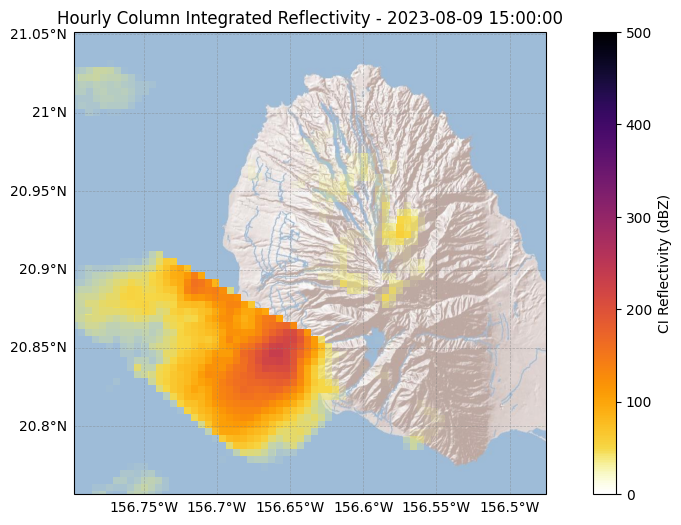

Processing file: PHMO20230809_160645_V06
Processing file: PHMO20230809_161335_V06
Processing file: PHMO20230809_162024_V06
Processing file: PHMO20230809_162719_V06
Processing file: PHMO20230809_163414_V06
Processing file: PHMO20230809_164108_V06
Processing file: PHMO20230809_164803_V06
Processing file: PHMO20230809_165458_V06


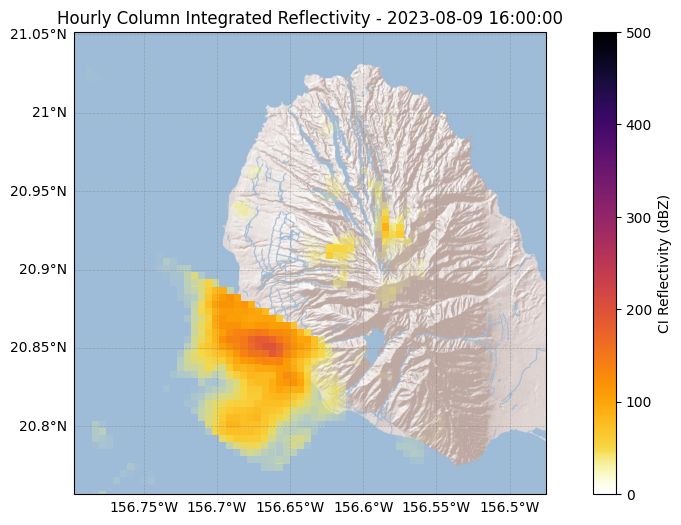

Processing file: PHMO20230809_170152_V06
Processing file: PHMO20230809_170846_V06
Processing file: PHMO20230809_171535_V06
Processing file: PHMO20230809_172224_V06
Processing file: PHMO20230809_172908_V06
Processing file: PHMO20230809_173552_V06
Processing file: PHMO20230809_174237_V06
Processing file: PHMO20230809_174926_V06
Processing file: PHMO20230809_175614_V06


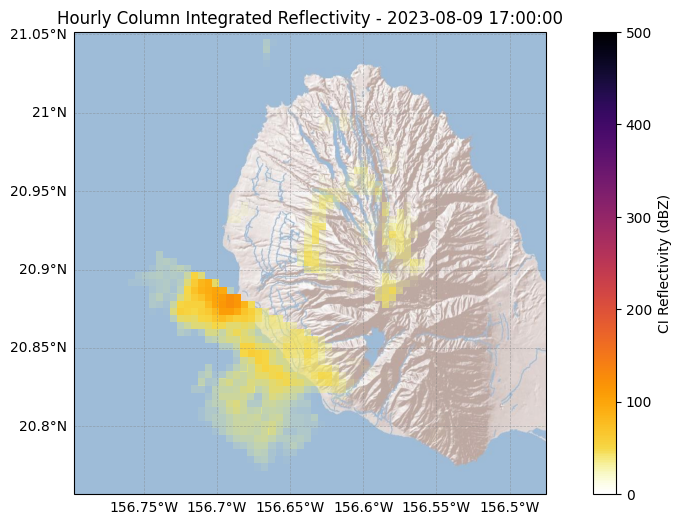

Processing file: PHMO20230809_180302_V06
Processing file: PHMO20230809_180951_V06
Processing file: PHMO20230809_181640_V06
Processing file: PHMO20230809_182324_V06
Processing file: PHMO20230809_183004_V06
Processing file: PHMO20230809_183652_V06
Processing file: PHMO20230809_184337_V06
Processing file: PHMO20230809_185022_V06
Processing file: PHMO20230809_185702_V06


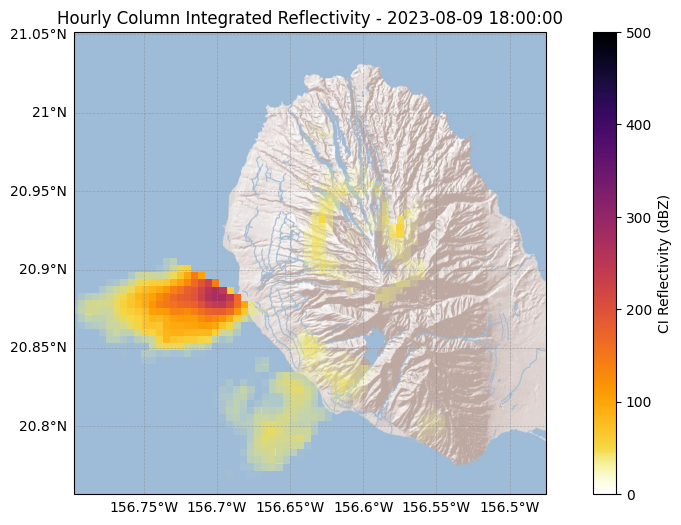

Processing file: PHMO20230809_190346_V06
Processing file: PHMO20230809_191030_V06
Processing file: PHMO20230809_191714_V06
Processing file: PHMO20230809_192211_V06
Processing file: PHMO20230809_192900_V06
Processing file: PHMO20230809_193555_V06
Processing file: PHMO20230809_194243_V06
Processing file: PHMO20230809_194938_V06
Processing file: PHMO20230809_195633_V06


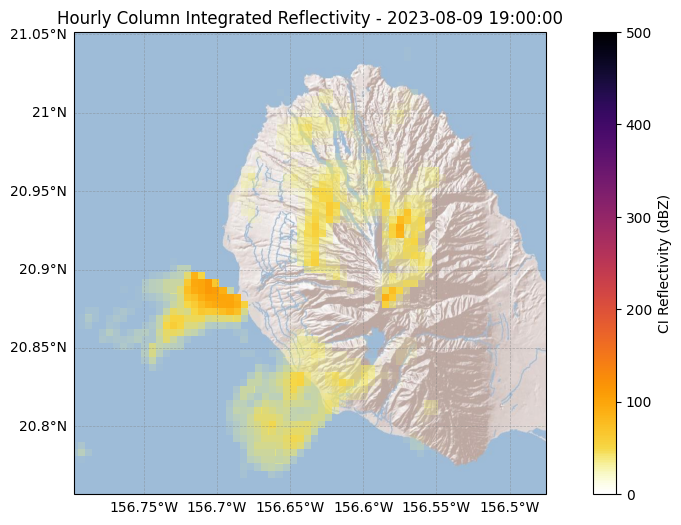

Processing file: PHMO20230809_200322_V06
Processing file: PHMO20230809_201007_V06
Processing file: PHMO20230809_201701_V06
Processing file: PHMO20230809_202345_V06
Processing file: PHMO20230809_203030_V06
Processing file: PHMO20230809_203725_V06
Processing file: PHMO20230809_204419_V06
Processing file: PHMO20230809_205113_V06
Processing file: PHMO20230809_205802_V06


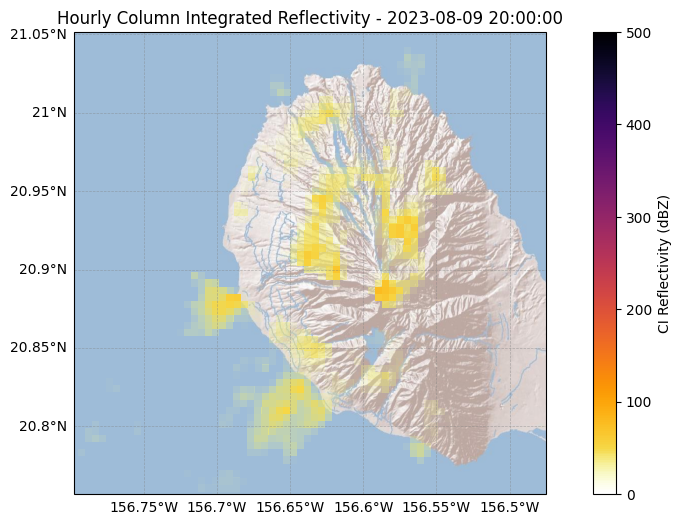

Processing file: PHMO20230809_210451_V06
Processing file: PHMO20230809_211140_V06
Processing file: PHMO20230809_211833_V06
Processing file: PHMO20230809_212517_V06
Processing file: PHMO20230809_213211_V06
Processing file: PHMO20230809_213900_V06
Processing file: PHMO20230809_214556_V06
Processing file: PHMO20230809_215250_V06
Processing file: PHMO20230809_215944_V06


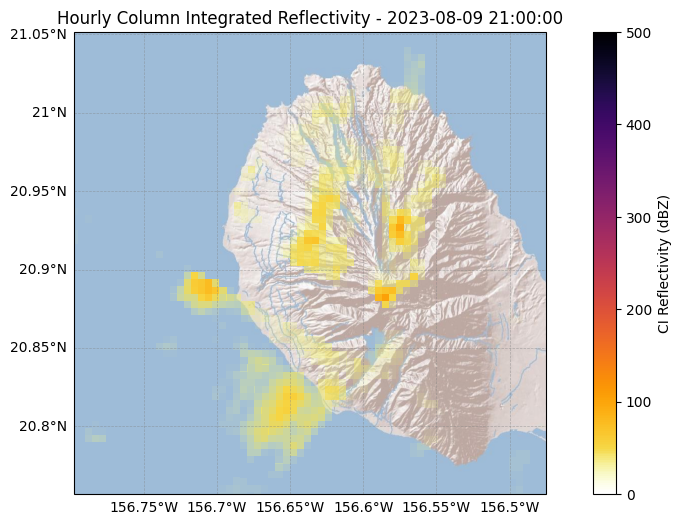

Processing file: PHMO20230809_220639_V06
Processing file: PHMO20230809_221334_V06
Processing file: PHMO20230809_222028_V06
Processing file: PHMO20230809_222723_V06
Processing file: PHMO20230809_223418_V06
Processing file: PHMO20230809_224113_V06
Processing file: PHMO20230809_224807_V06
Processing file: PHMO20230809_225501_V06


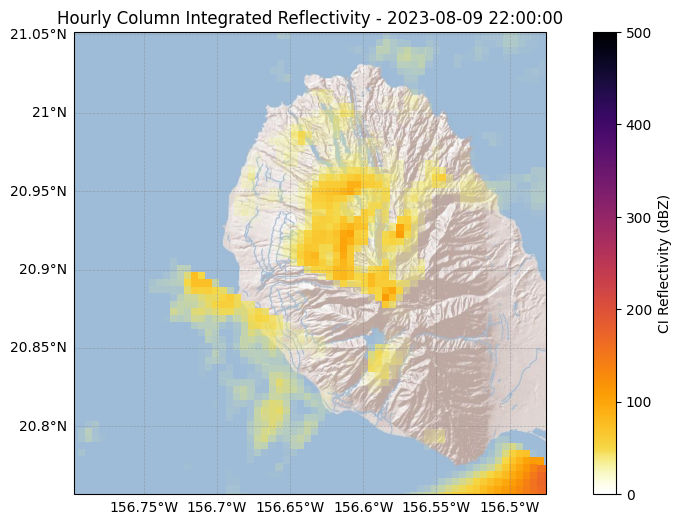

Processing file: PHMO20230809_230156_V06
Processing file: PHMO20230809_230851_V06
Processing file: PHMO20230809_231540_V06
Processing file: PHMO20230809_232234_V06
Processing file: PHMO20230809_232928_V06
Processing file: PHMO20230809_233623_V06
Processing file: PHMO20230809_234318_V06
Processing file: PHMO20230809_235013_V06
Processing file: PHMO20230809_235707_V06


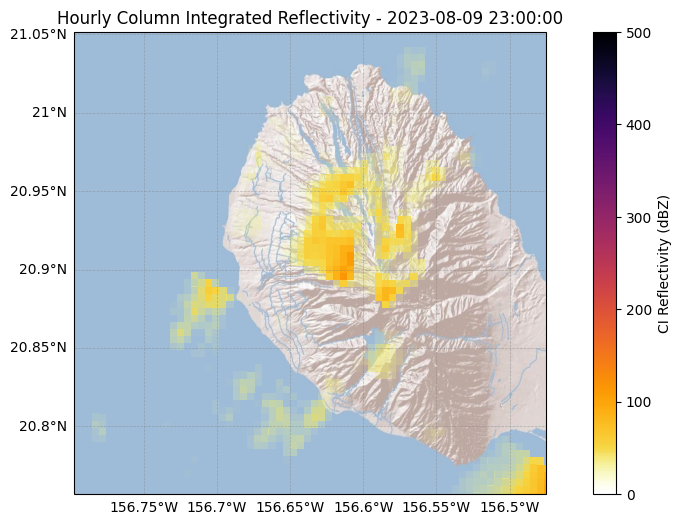

In [ ]:
# loop through groups creating hourly averages

ci_hourly = []
# cw-hourly
for item in df.groupby(pd.Grouper(freq='H')):
  group_ci = []
  for f in item[1].filenames:
    radar_filepath = os.path.join(radar_data_dir, f)
    try:

      # Read radar data using pyart
      print(f"Processing file: {f}")
      radar = pyart.io.read(radar_filepath)
      grid = pyart.map.grid_from_radars((radar,), grid_shape=(40, 300, 300), \
              grid_limits=((0, 5000), (-100000, 50000.0), (-50000, 100000.0)), fields=['reflectivity','spectrum_width','clutter_filter_power_removed' ])
      ref = grid.fields['reflectivity']['data']
      spec = grid.fields['spectrum_width']['data']
      clut = grid.fields['clutter_filter_power_removed']['data']

      masked_ref = np.ma.masked_where((spec > 8) | ((clut.data > 10) & (spec > 5)), ref)

      # Compute and plot the column total
      # column_total = np.nansum(ref,0)
      column_total = np.nansum(masked_ref,0)

      group_ci.append(column_total)

    except Exception as e:
      print(f"Error processing file {f}: {e}")

  group_mean = np.nanmean(group_ci, axis=0)
  ci_hourly.append(group_mean)

  # Plot hourly column total
  lon, lat = grid.get_point_longitude_latitude(0)
  # Create a figure
  fig = plt.figure(figsize=(12,6))
  # Set the GeoAxes to the projection used by WRF
  ax = plt.axes(projection=ShadedReliefESRI().crs)

  #larger coverage
  # ax.set_extent([lon.min(),lon.max(), lat.min(), lat.max()])
  # ax.add_image(ShadedReliefESRI(), 9)

  #to match wrf d03
    ax.set_extent([-156.79762, -156.47496, 20.756805, 21.051483])

  # ax.set_extent([-156.79762, -156.47496, 20.756805, 21.051483])
  ax.add_image(ShadedReliefESRI(), 12)
  plt.pcolormesh(lon, lat, group_mean, cmap=alpha_cmap, vmin=0,transform=ccrs.PlateCarree(), vmax=500)
  plt.title(f"Hourly Column Integrated Reflectivity - {item[0]}")
  gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True,linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
  gl.top_labels = False
  gl.right_labels = False
  plt.colorbar(label='CI Reflectivity (dBZ)')
  plt.savefig(fig_path + f'ci_smoke_{item[0]}_small.png', dpi=300)

  plt.show()



